<a href="https://colab.research.google.com/github/pazcalll/PCVK_Genap_2021/blob/main/weekfinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import sys
import os
import cv2 as cv
import numpy as np
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt

from PIL import Image, ImageDraw
from math import sqrt, pi, cos, sin
from collections import defaultdict

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


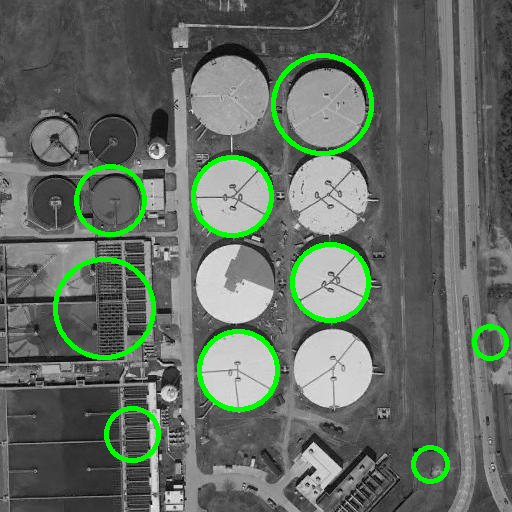

In [ ]:
img = cv.imread('/content/drive/MyDrive/PCVK/last/06_0_6.jpg',0)
cimg = cv.cvtColor(img,cv.COLOR_GRAY2BGR)
gray = cv.Canny(img, 10, 150, apertureSize = 3)

kernel = np.ones((3,3), np.uint8) 
edges = cv.dilate(gray,kernel,iterations = 1)

kernel = np.ones((5,5), np.uint8) 
edges = cv.erode(edges, kernel, iterations = 1)

circles = cv.HoughCircles(gray,cv.HOUGH_GRADIENT,1,img.shape[0]/5,
                        param1=100,param2=40,minRadius=10,maxRadius=50)

circles = np.uint16(np.around(circles))
for i in circles[0,:]:
  # draw the outer circle
  cv.circle(cimg,(i[0],i[1]),i[2],(0,255,0),3)
  # draw the center of the circle
  # cv.circle(cimg,(i[0],i[1]),2,(0,0,255),1)

cv2_imshow(cimg)

In [ ]:
from math import sqrt, atan2, pi
import numpy as np

def canny_edge_detector(input_image):
    input_pixels = input_image.load()
    width = input_image.width
    height = input_image.height

    # Transform the image to grayscale
    grayscaled = compute_grayscale(input_pixels, width, height)

    # Blur it to remove noise
    blurred = compute_blur(grayscaled, width, height)

    # Compute the gradient
    gradient, direction = compute_gradient(blurred, width, height)

    # Non-maximum suppression
    filter_out_non_maximum(gradient, direction, width, height)

    # Filter out some edges
    keep = filter_strong_edges(gradient, width, height, 20, 25)

    return keep


def compute_grayscale(input_pixels, width, height):
    grayscale = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            pixel = input_pixels[x, y]
            grayscale[x, y] = (pixel[0] + pixel[1] + pixel[2]) / 3
    return grayscale


def compute_blur(input_pixels, width, height):
    # Keep coordinate inside image
    clip = lambda x, l, u: l if x < l else u if x > u else x

    # Gaussian kernel
    kernel = np.array([
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [6 / 256, 24 / 256, 36 / 256, 24 / 256, 6 / 256],
        [4 / 256, 16 / 256, 24 / 256, 16 / 256, 4 / 256],
        [1 / 256,  4 / 256,  6 / 256,  4 / 256, 1 / 256]
    ])

    # Middle of the kernel
    offset = len(kernel) // 2

    # Compute the blurred image
    blurred = np.empty((width, height))
    for x in range(width):
        for y in range(height):
            acc = 0
            for a in range(len(kernel)):
                for b in range(len(kernel)):
                    xn = clip(x + a - offset, 0, width - 1)
                    yn = clip(y + b - offset, 0, height - 1)
                    acc += input_pixels[xn, yn] * kernel[a, b]
            blurred[x, y] = int(acc)
    return blurred


def compute_gradient(input_pixels, width, height):
    gradient = np.zeros((width, height))
    direction = np.zeros((width, height))
    for x in range(width):
        for y in range(height):
            if 0 < x < width - 1 and 0 < y < height - 1:
                magx = input_pixels[x + 1, y] - input_pixels[x - 1, y]
                magy = input_pixels[x, y + 1] - input_pixels[x, y - 1]
                gradient[x, y] = sqrt(magx**2 + magy**2)
                direction[x, y] = atan2(magy, magx)
    return gradient, direction


def filter_out_non_maximum(gradient, direction, width, height):
    for x in range(1, width - 1):
        for y in range(1, height - 1):
            angle = direction[x, y] if direction[x, y] >= 0 else direction[x, y] + pi
            rangle = round(angle / (pi / 4))
            mag = gradient[x, y]
            if ((rangle == 0 or rangle == 4) and (gradient[x - 1, y] > mag or gradient[x + 1, y] > mag)
                    or (rangle == 1 and (gradient[x - 1, y - 1] > mag or gradient[x + 1, y + 1] > mag))
                    or (rangle == 2 and (gradient[x, y - 1] > mag or gradient[x, y + 1] > mag))
                    or (rangle == 3 and (gradient[x + 1, y - 1] > mag or gradient[x - 1, y + 1] > mag))):
                gradient[x, y] = 0


def filter_strong_edges(gradient, width, height, low, high):
    # Keep strong edges
    keep = set()
    for x in range(width):
        for y in range(height):
            if gradient[x, y] > high:
                keep.add((x, y))

    # Keep weak edges next to a pixel to keep
    lastiter = keep
    while lastiter:
        newkeep = set()
        for x, y in lastiter:
            for a, b in ((-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)):
                if gradient[x + a, y + b] > low and (x+a, y+b) not in keep:
                    newkeep.add((x+a, y+b))
        keep.update(newkeep)
        lastiter = newkeep

    return list(keep)

# src = []
# filenames = []
# iterate = 0
# for filename in os.listdir('/content/drive/MyDrive/PCVK/last/'):
#       if filename.endswith("jpg"): 
#           # Your code comes here such as 
#           # print(filename)
#           # filenames.append(filename)
#           combine = {
#               'filename': filename,
#               'img' :  Image.open('/content/drive/MyDrive/PCVK/last/'+filename),
#           }
#           src.append(combine)
#           iterate=+1;

# for combine in src:
#   print(combine['filename'])
#   # Load image:
#   input_image = combine['img']
  
#   # Output image:
#   output_image = Image.new("RGB", input_image.size)
#   output_image.paste(input_image)
#   draw_result = ImageDraw.Draw(output_image)

#   # Find circles
#   rmin = 11
#   rmax = 100
#   steps = 100
#   threshold = 0.55

#   points = []
#   for r in range(rmin, rmax + 1):
#       for t in range(steps):
#           points.append((r, int(r * cos(2 * pi * t / steps)), int(r * sin(2 * pi * t / steps))))

#   acc = defaultdict(int)
#   for x, y in canny_edge_detector(input_image):
#       for r, dx, dy in points:
#           a = x - dx
#           b = y - dy
#           acc[(a, b, r)] += 1

#   circles = []
#   counter_c = 0
#   for k, v in sorted(acc.items(), key=lambda i: -i[1]):
#       x, y, r = k
#       if v / steps >= threshold and all((x - xc) ** 2 + (y - yc) ** 2 > rc ** 2 for xc, yc, rc in circles):
#           # print(v / steps, x, y, r)
#           circles.append((x, y, r))
#           counter_c =+1

#   for x, y, r in circles:
#       draw_result.ellipse((x-r, y-r, x+r, y+r), outline=(255,0,0,0))
  
#   print(counter_c)
#   plt.figure(figsize=(8, 8))
#   plt.imshow(output_image)

9


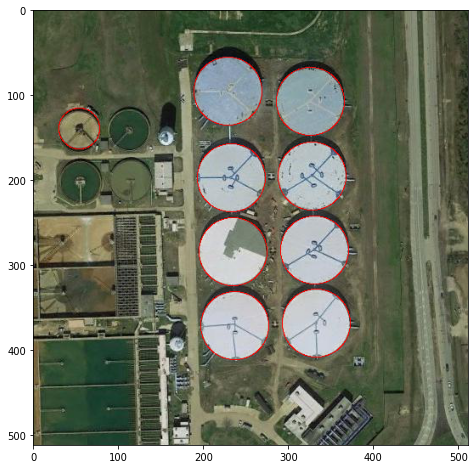

In [ ]:
# Load image:
input_image = Image.open("/content/drive/MyDrive/PCVK/last/06_0_6.jpg")

# Output image:
output_image = Image.new("RGB", input_image.size)
output_image.paste(input_image)
draw_result = ImageDraw.Draw(output_image)
output_image.show()
# Find circles
rmin = 15
rmax = 100
steps = 100
threshold = 0.55

points = []
for r in range(rmin, rmax + 1):
    for t in range(steps):
        points.append((r, int(r * cos(2 * pi * t / steps)), int(r * sin(2 * pi * t / steps))))

acc = defaultdict(int)
for x, y in canny_edge_detector(input_image):
    for r, dx, dy in points:
        a = x - dx
        b = y - dy
        acc[(a, b, r)] += 1

circles = []
counter=0
for k, v in sorted(acc.items(), key=lambda i: -i[1]):
    x, y, r = k
    if v / steps >= threshold and all((x - xc) ** 2 + (y - yc) ** 2 > rc ** 2 for xc, yc, rc in circles):
        # print(v / steps, x, y, r)
        counter = counter + 1
        circles.append((x, y, r))

for x, y, r in circles:
    draw_result.ellipse((x-r, y-r, x+r, y+r), outline=(255,0,0,0))

print(counter)
plt.figure(figsize=(8, 8))
plt.imshow(output_image)


In [ ]:
def main():
    
    default_file = '/content/drive/MyDrive/PCVK/last/01_2_8.jpg'

    src = []
    filenames = []
    iterate = 0
    for filename in os.listdir('/content/drive/MyDrive/PCVK/last/'):
      if filename.endswith("jpg"): 
          # Your code comes here such as 
          # print(filename)
          # filenames.append(filename)
          combine = {
              'filename': filename,
              'img' :  cv.imread('/content/drive/MyDrive/PCVK/last/'+filename, cv.IMREAD_COLOR),
          }
          src.append(combine)
          iterate=+1;

    for combine in src:
      print(combine['filename'])
      # cv2_imshow(combine['img'])
      gray = cv.cvtColor(combine['img'], cv.COLOR_BGR2GRAY)
      gray = cv.Canny(gray, 30, 180, apertureSize = 3)
      # gray = cv.medianBlur(gray, 5)
      rows = gray.shape[0]
      circles = cv.HoughCircles(gray, cv.HOUGH_GRADIENT, 1, rows / 8,
                                param1=100, param2=30,
                                minRadius=1, maxRadius=30)
    
    
      if circles is not None:
          circles = np.uint16(np.around(circles))
          for i in circles[0, :]:
              center = (i[0], i[1])
              # circle center
              cv.circle(combine['img'], center, 1, (0, 100, 100), 3)
              # circle outline
              radius = i[2]
              cv.circle(combine['img'], center, radius, (255, 0, 255), 3)
      cv2_imshow(combine['img'])
    

05_8_8.jpg


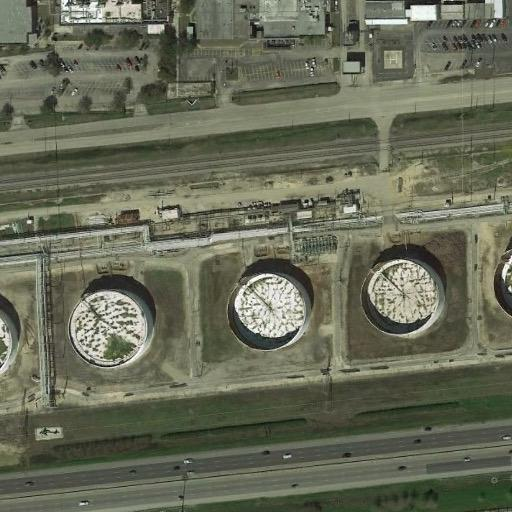

04_9_6.jpg


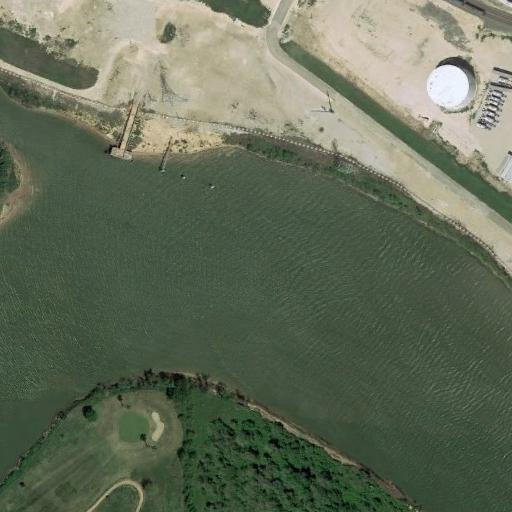

05_9_7.jpg


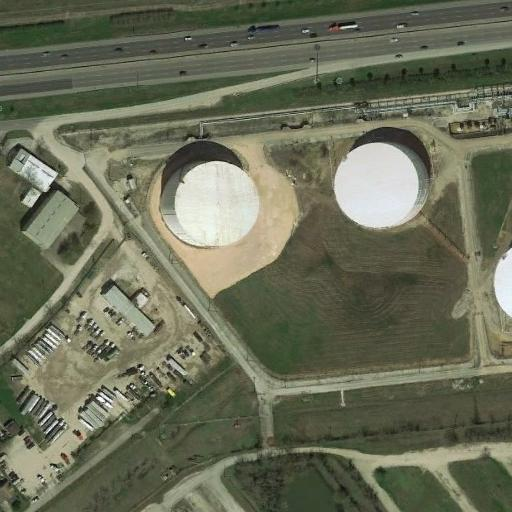

06_2_5.jpg


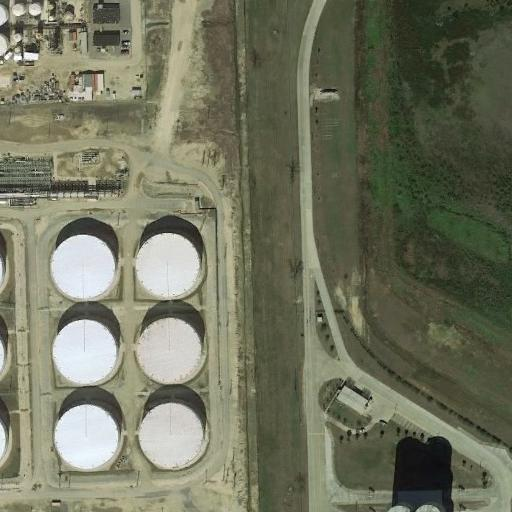

06_0_6.jpg


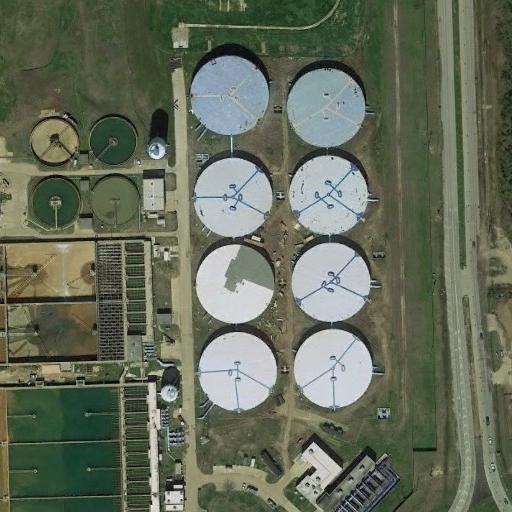

06_3_8.jpg


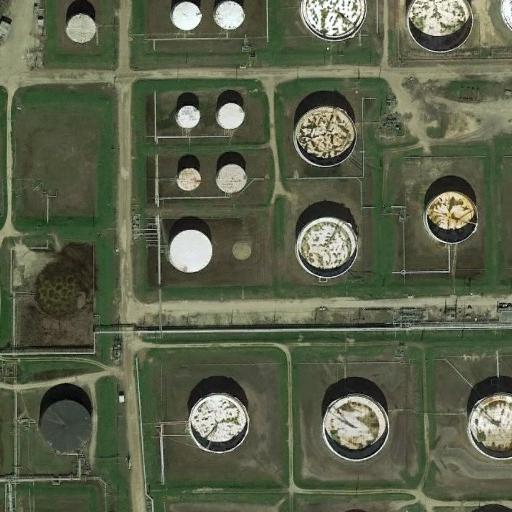

06_4_2.jpg


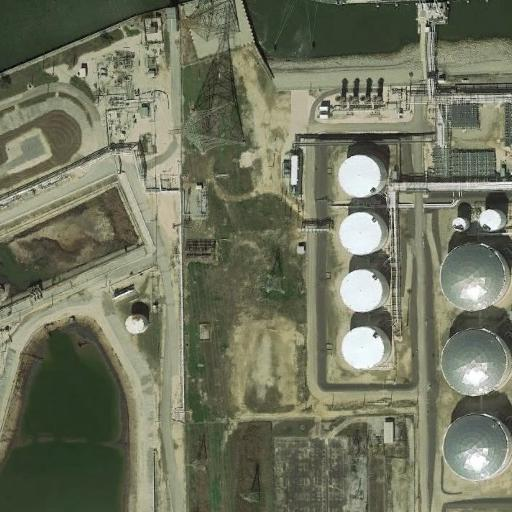

01_2_8.jpg


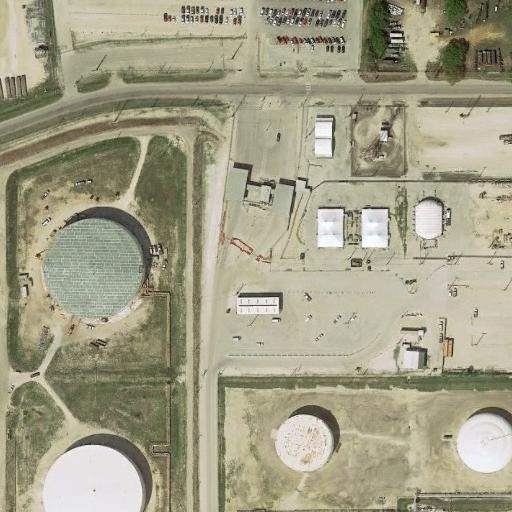

01_8_1.jpg


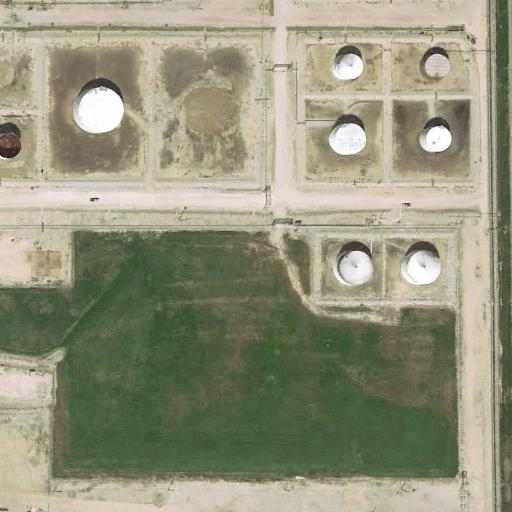

01_8_7.jpg


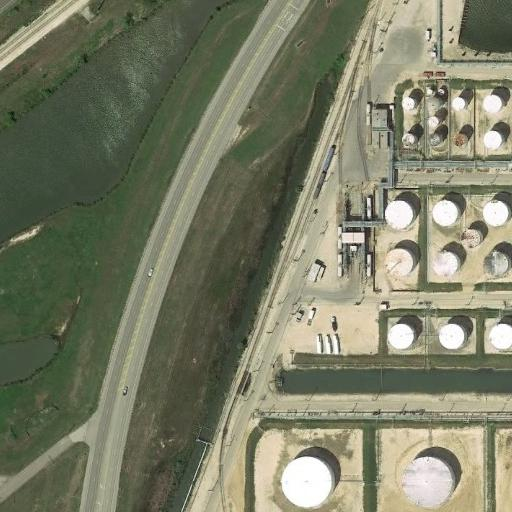

01_9_9.jpg


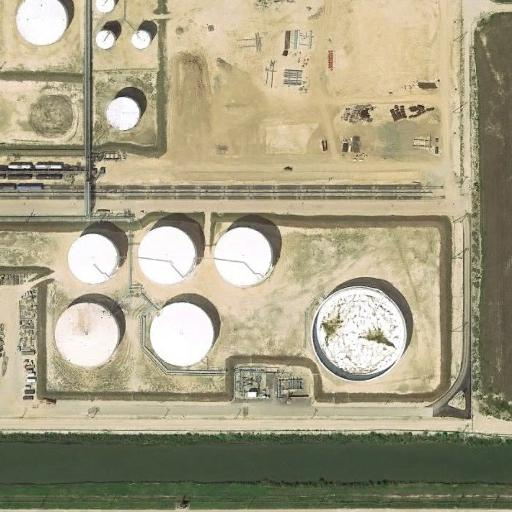

02_6_4.jpg


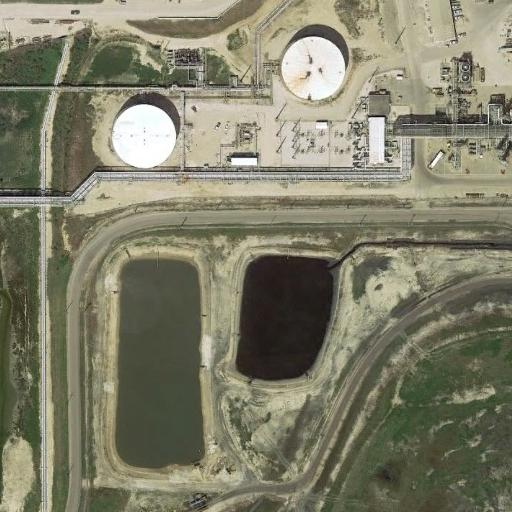

02_7_3.jpg


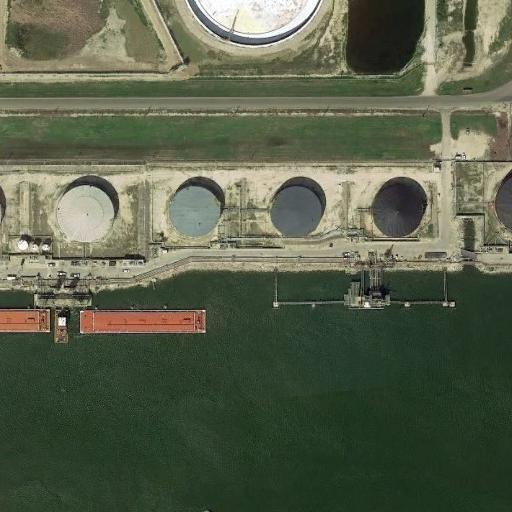

03_5_9.jpg


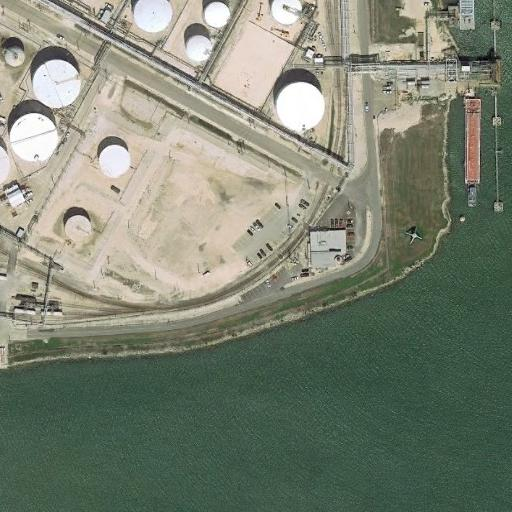

05_1_9.jpg


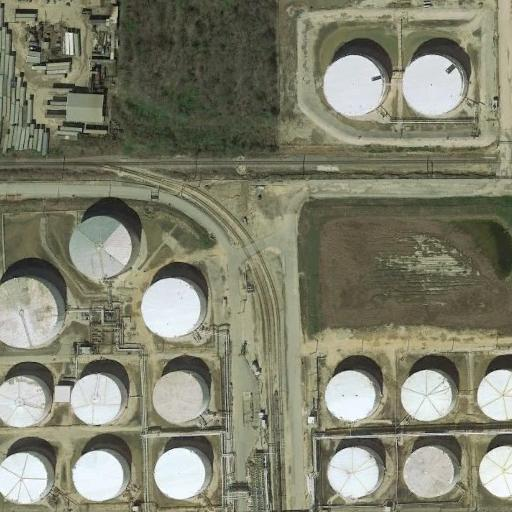

05_6_3.jpg


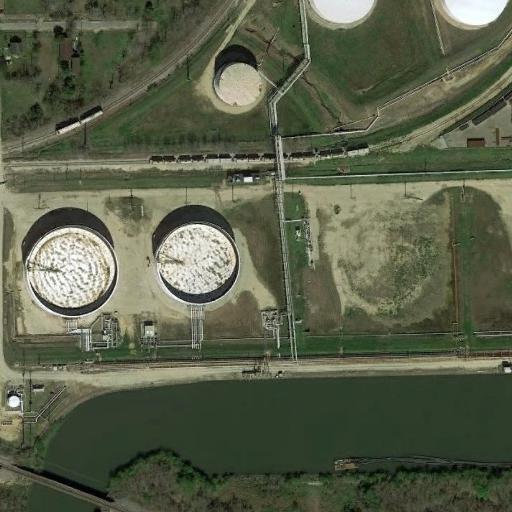

05_7_6.jpg


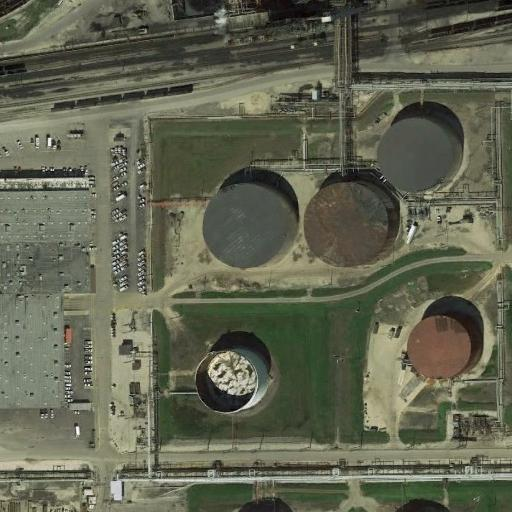

05_8_4.jpg


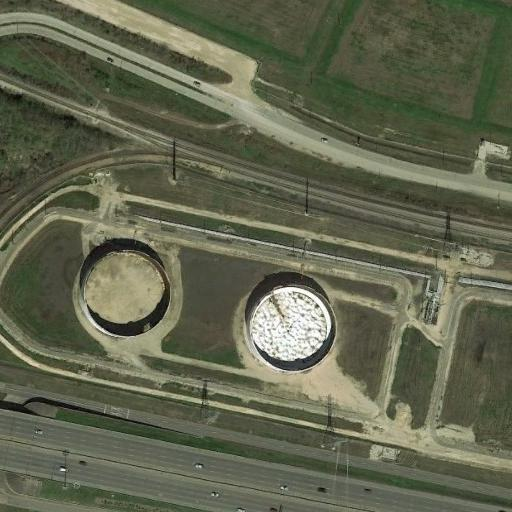

05_8_5.jpg


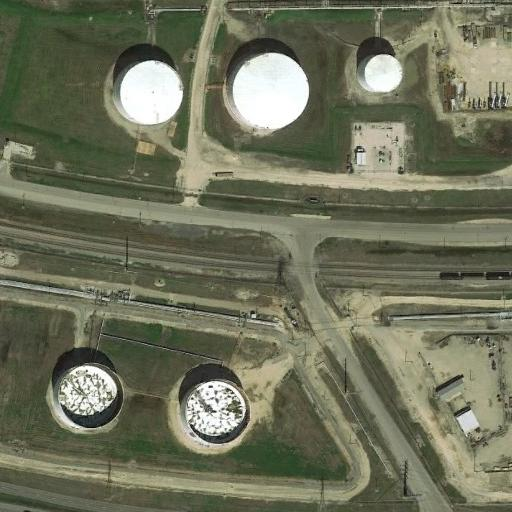

06_4_7.jpg


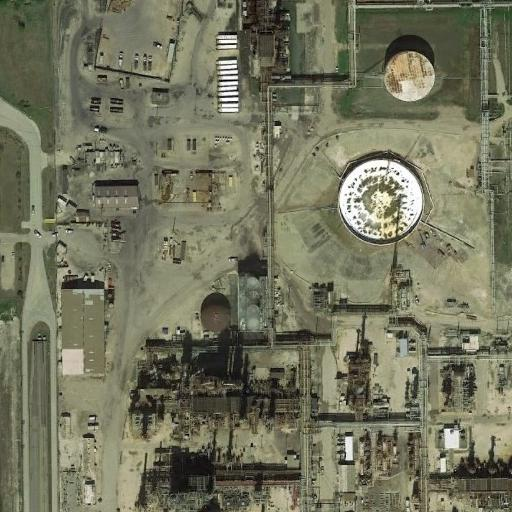

01_3_9.jpg


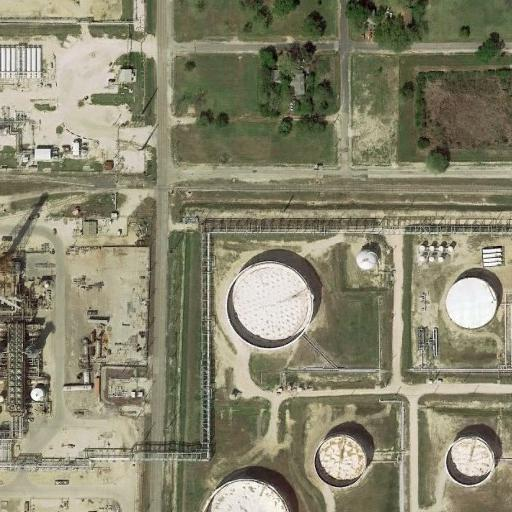

01_4_2.jpg


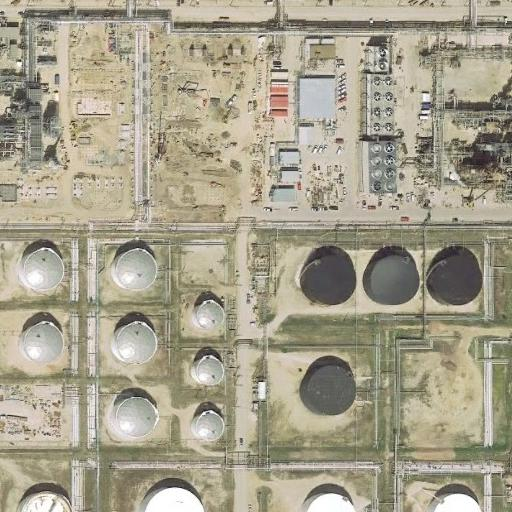

01_5_3.jpg


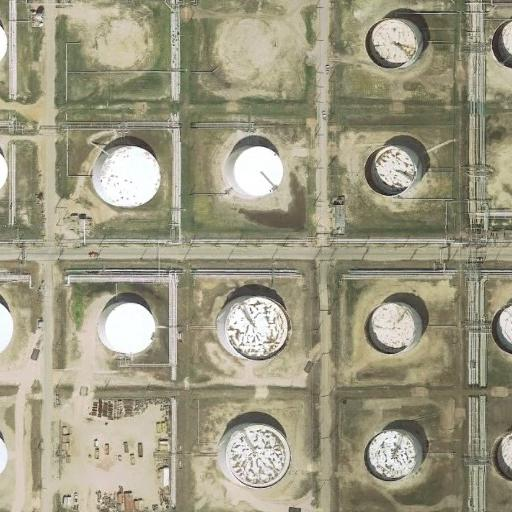

01_4_9.jpg


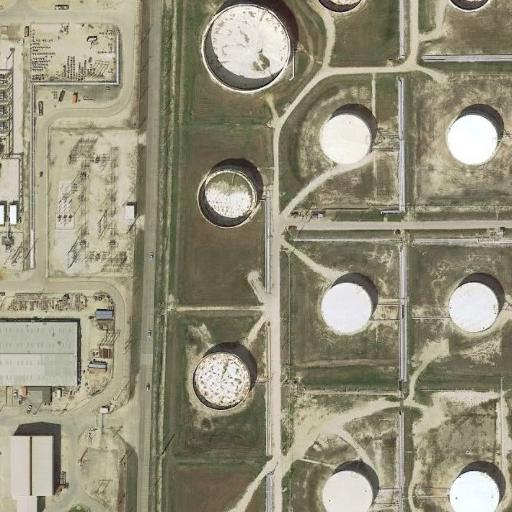

01_5_7.jpg


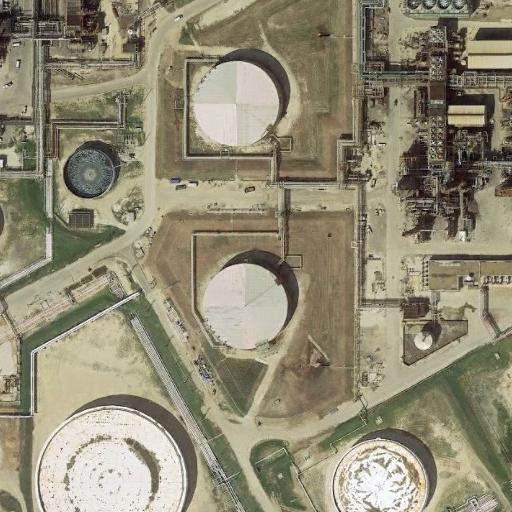

01_5_9.jpg


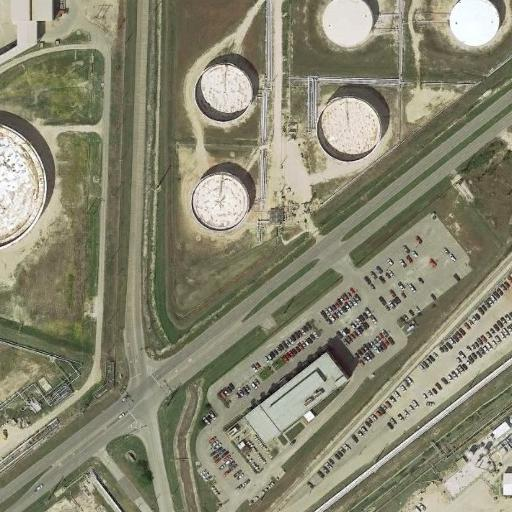

01_6_4.jpg


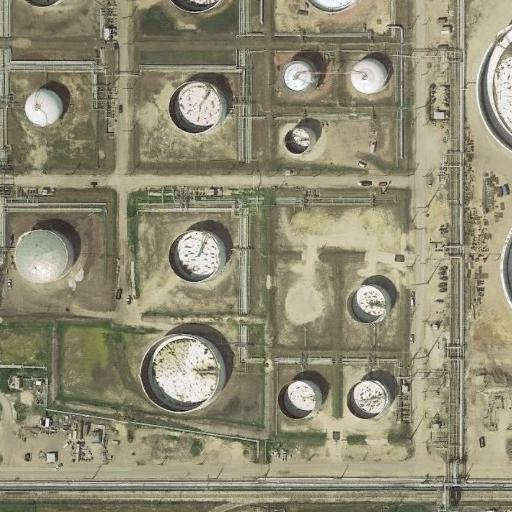

01_6_5.jpg


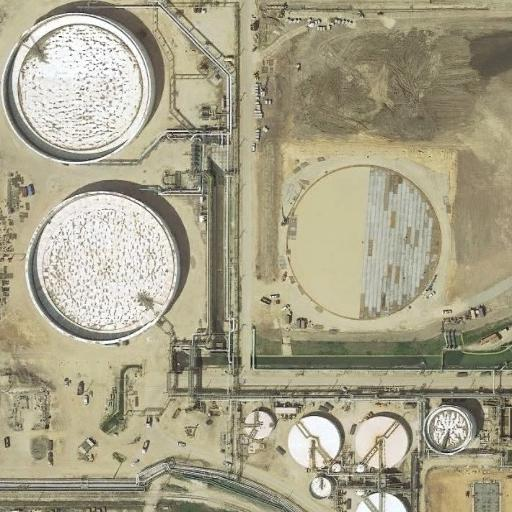

01_6_8.jpg


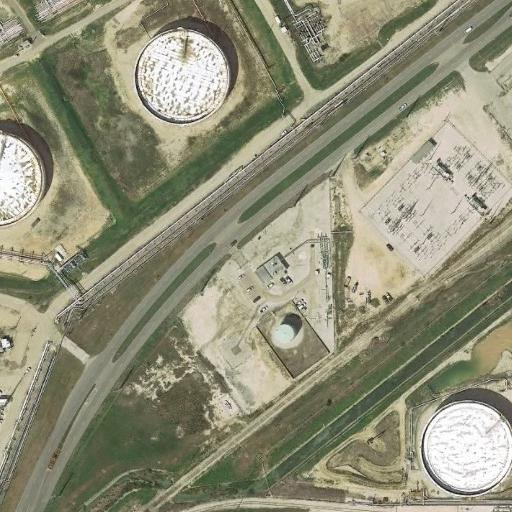

01_8_8.jpg


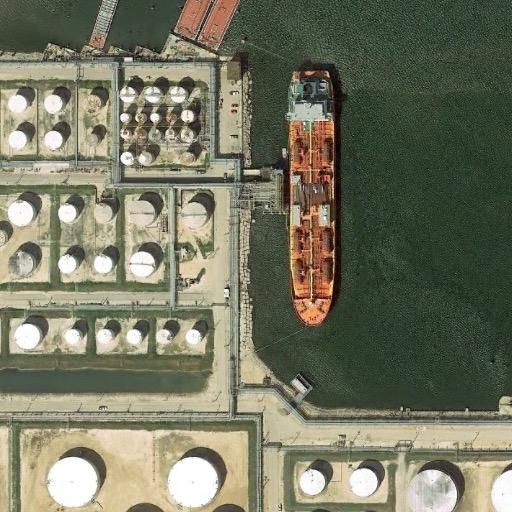

01_9_8.jpg


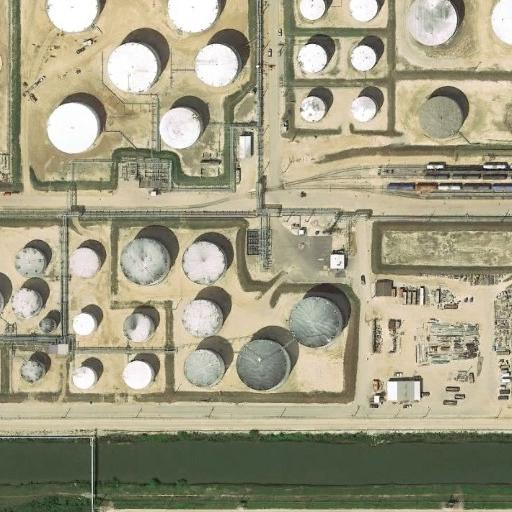

02_1_7.jpg


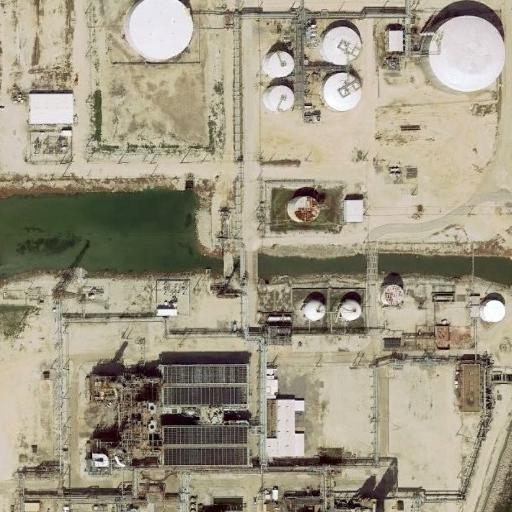

02_2_3.jpg


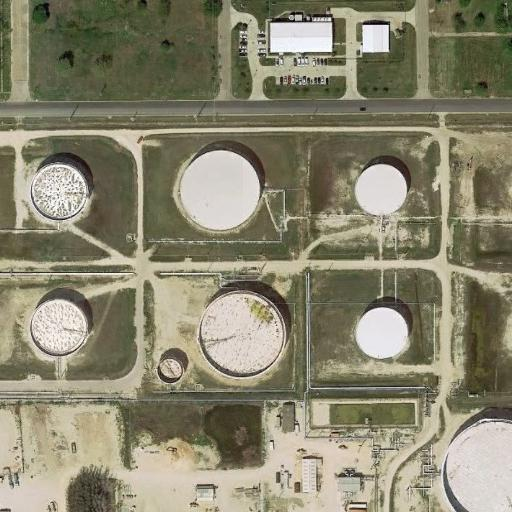

02_3_1.jpg


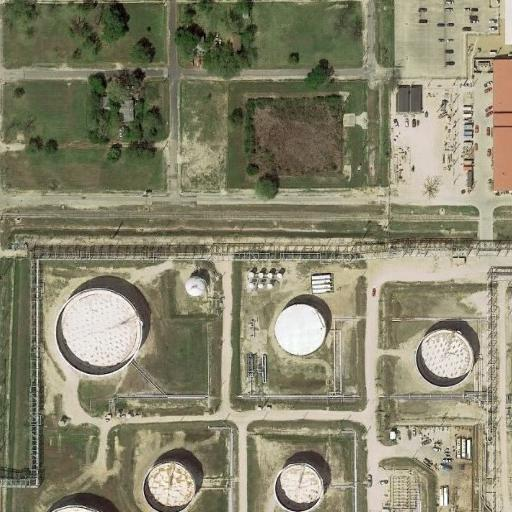

02_4_1.jpg


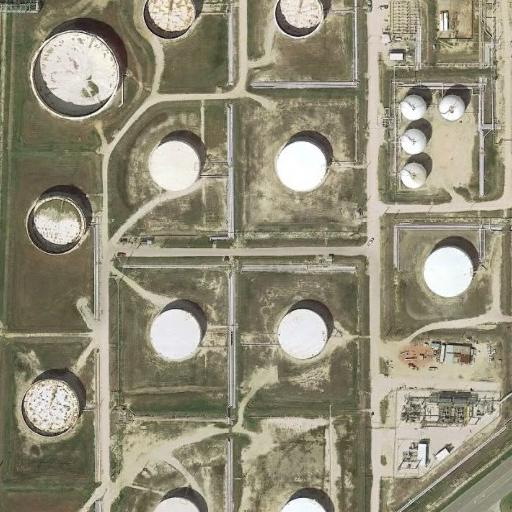

02_5_0.jpg


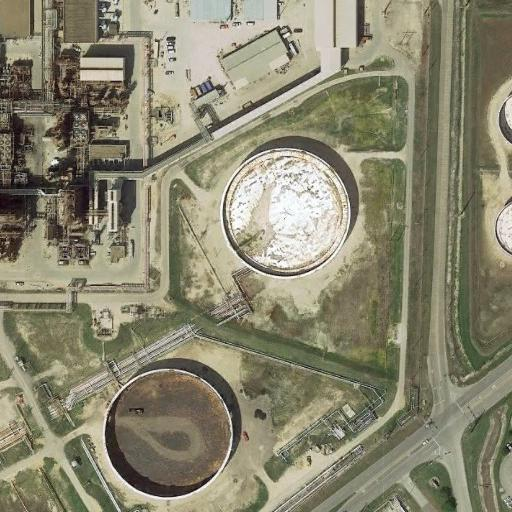

05_2_9.jpg


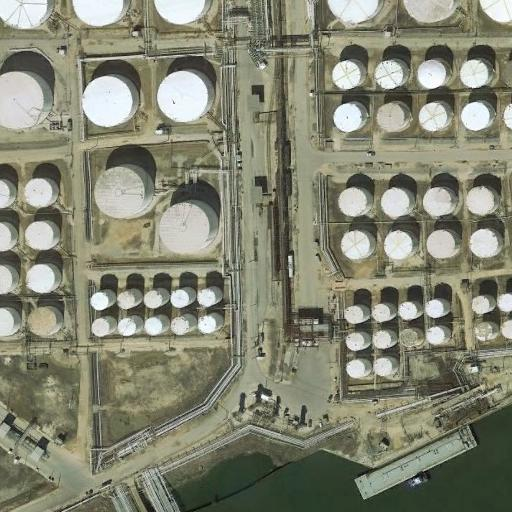

01_3_6.jpg


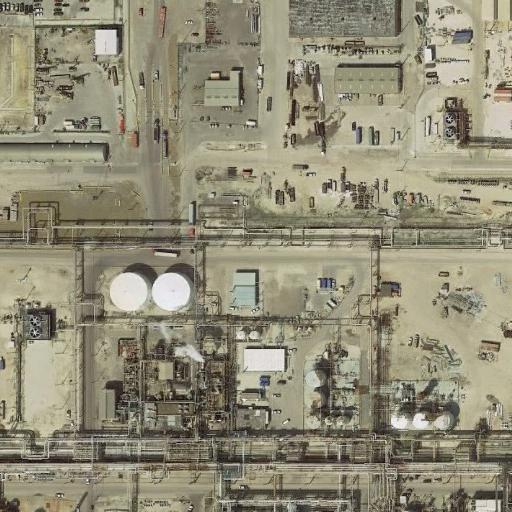

05_4_4.jpg


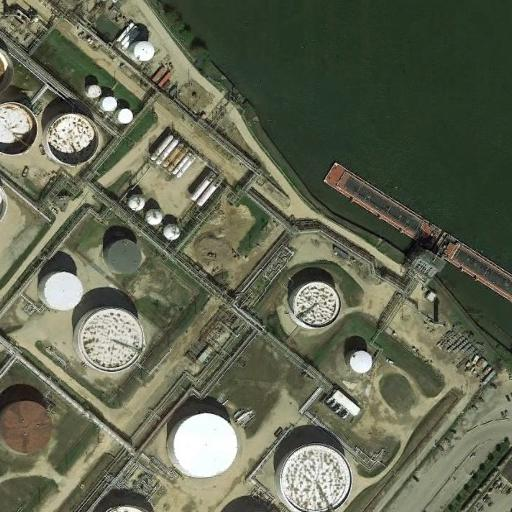

01_5_8.jpg


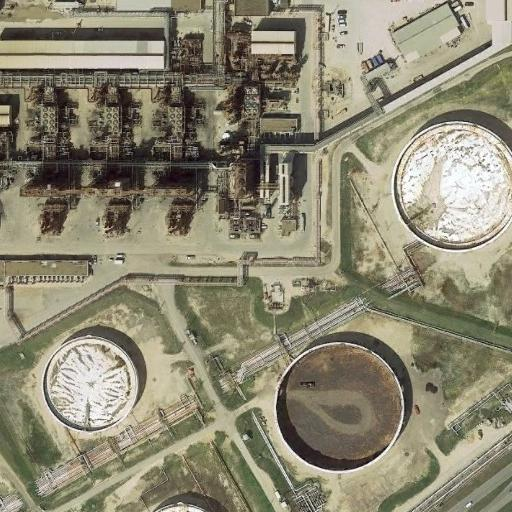

In [ ]:
main()